# Panorama Image Stitching Project
This project focuses on generating a seamless panorama by stitching together multiple overlapping images.
The goal is to explore key concepts in computer vision, including feature detection, matching, and image blending.  

By implementing this process, I aim to deepen my understanding of image transformation, homography estimation, and
the overall workflow involved in automating the panorama creation commonly seen in modern photography software.  
 


In [1]:
# Load required Libraries
import numpy as np
import cv2
from matplotlib import pyplot as plt
import os

# Panorama Image Stitching Workflow
In this project, the goal is to perform image stitching on multiple sets of input images to generate panoramic views.  
The workflow involves reading in the images, reordering them for alignment, and implementing the panorama stitching process. 

First, multiple image sets are loaded for testing, allowing experimentation with different scenarios.  
The images are reordered to ensure the central image serves as the "source" or reference, with the panorama expanding to both sides.  

Next, the core of the project lies in the panorama stitching itself. The implementation merges multiple images, unlike many  
online examples that typically handle only two images. Although this project focuses on horizontal merges, the approach can  
be easily extended to vertical panoramas.   

Finally, it's important to note that stitching quality may vary depending on the number of input images. While stitching  
two images often produces good results, merging more than two can lead to perspective issues. Therefore, different image  
sets will be tested to observe the impact on final output quality.  


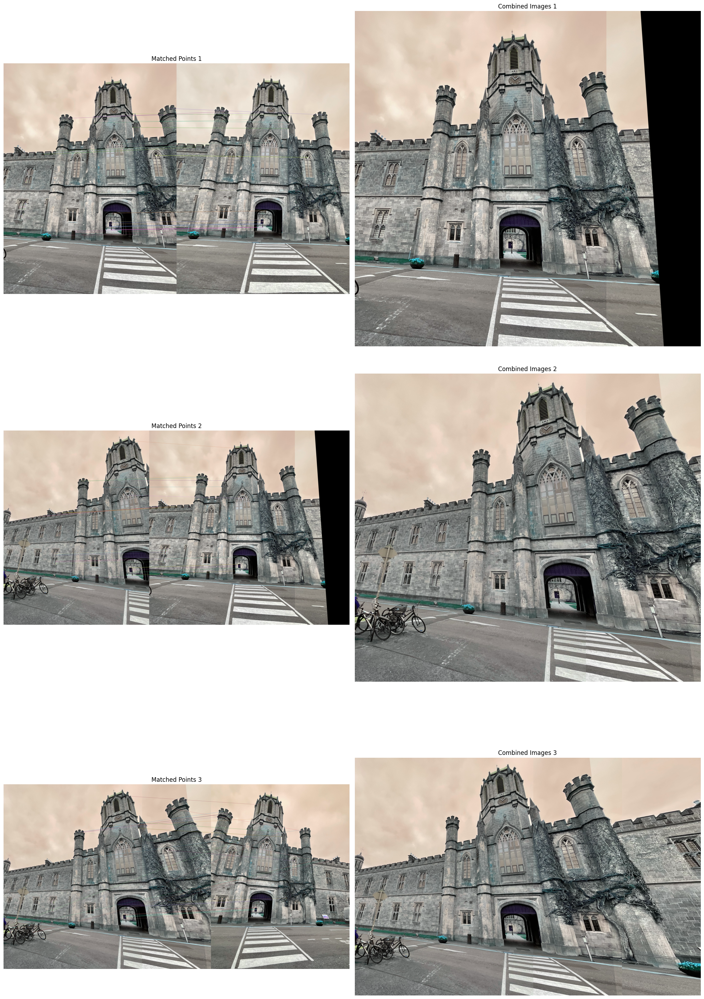

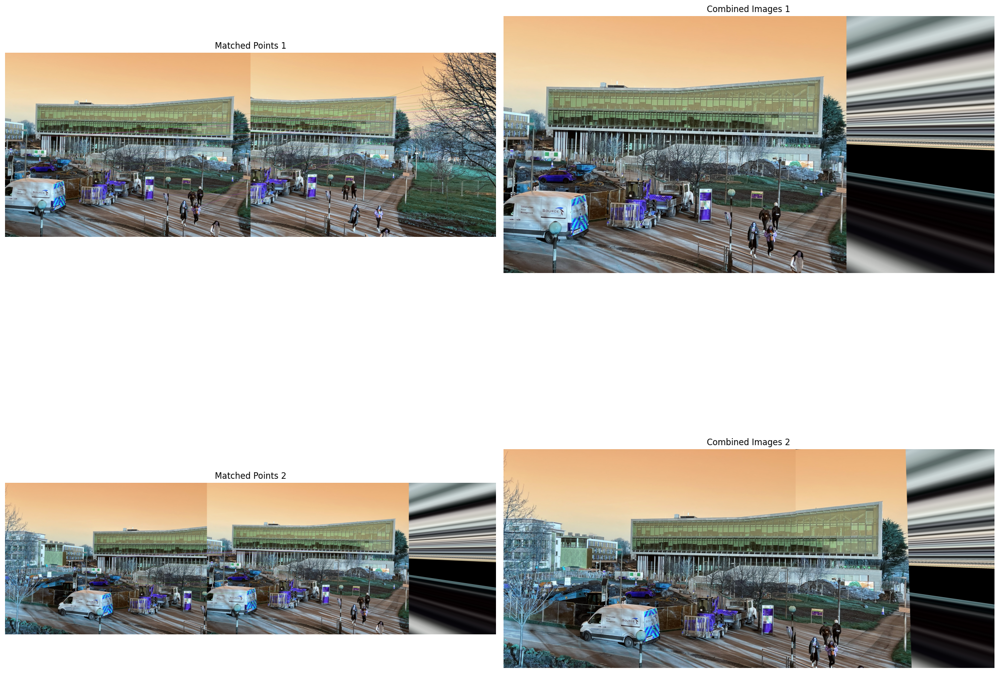

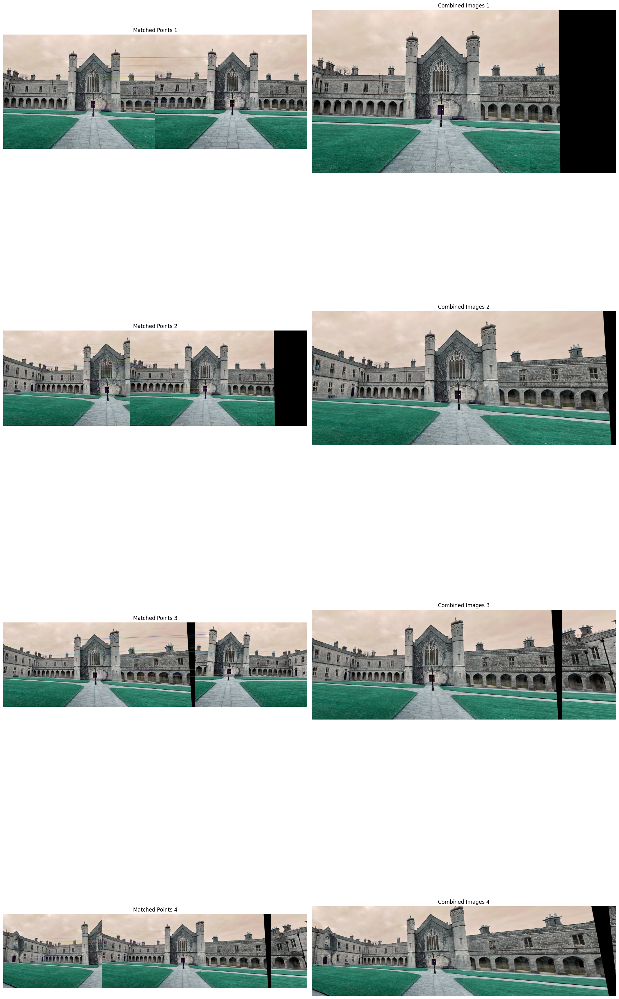

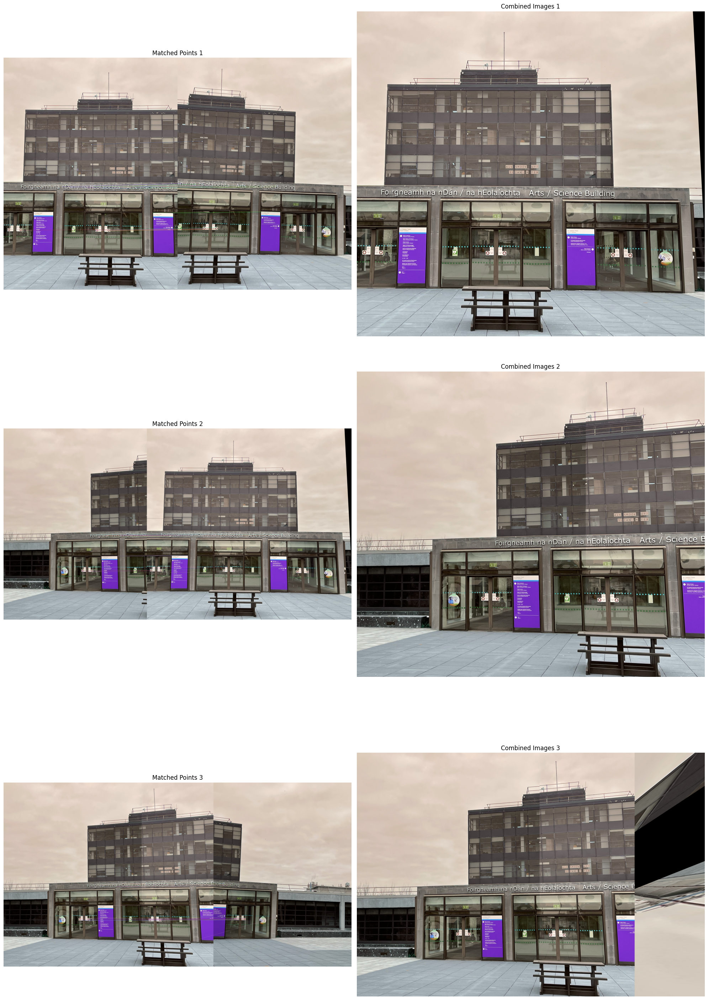

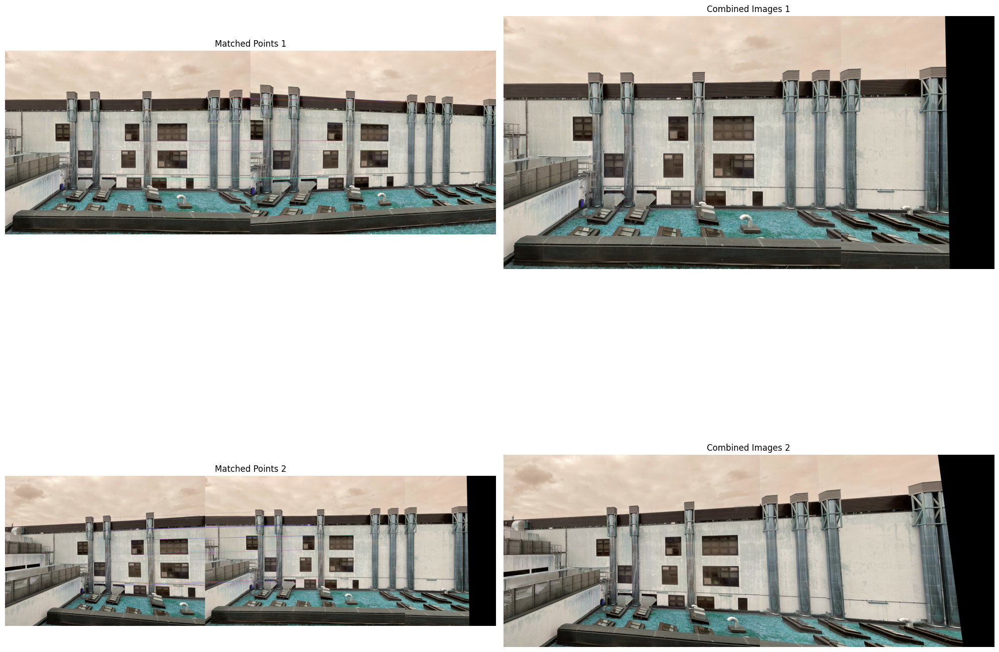

In [2]:
# Define the paths for different image sets
input_paths = [
    'images/set_1/',
    'images/set_2/',
    'images/set_3/',
    'images/set_4/',
    'images/set_5/'
]

# Loop through each image set
for input_path in input_paths:
    filenames = [input_path + filename for filename in os.listdir(input_path)]
    raw_images = [cv2.imread(filename) for filename in filenames]
    count = len(raw_images)

    # Reorder images so the middle one becomes the source image, making stitching easier
    images = []
    new_idx = (count - 1) // 2
    k = -1
    for i in range(count):
        new_idx = new_idx + k * i
        images.append(raw_images[new_idx])
        k *= -1

    img_src = images[0]

    matched_point_images = []
    combined_images = []

    for i in range(1, len(images)):
        img_dst = images[i]
        if i % 2 == 0: # Alternate the source and destination image to balance stitching direction
            img_src, img_dst = img_dst, img_src

        # Initialize ORB (Oriented FAST and Rotated BRIEF) detector to find keypoints and descriptors
        orb = cv2.ORB_create()
        kp1, des1 = orb.detectAndCompute(img_src, None)
        kp2, des2 = orb.detectAndCompute(img_dst, None)

        # Use Brute-Force Matcher (BFMatcher) to find the best matches between descriptors
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
        matches = bf.match(des1, des2)

        # Sort the matches by distance (i.e., similarity), keeping the 50 best matches
        matches = sorted(matches, key=lambda x: x.distance)
        matches = matches[:50]

        # Create arrays to store the coordinates of matched keypoints
        src_pts = np.zeros((len(matches), 2), dtype=np.float32).reshape(-1, 1, 2)
        dst_pts = np.zeros((len(matches), 2), dtype=np.float32).reshape(-1, 1, 2)
        for i, match in enumerate(matches):
            src_pts[i, :] = kp1[match.queryIdx].pt
            dst_pts[i, :] = kp2[match.trainIdx].pt

        # Find homography (transformation matrix) between destination and source images using RANSAC to handle outliers
        M, mask = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)

        # Draw matched keypoints on the images for visualization
        match_img = cv2.drawMatches(img_src, kp1, img_dst, kp2, matches, None)
        matched_point_images.append(match_img)

        h1, w1, p1 = img_src.shape
        h2, w2, p2 = img_dst.shape
        h = np.maximum(h1, h2)
        w = np.maximum(w1, w2)

        # Calculate displacement to shift the destination image to align with the source image
        move_dis = int(np.maximum(dst_pts[0][0][0], src_pts[0][0][0]))

        # Apply perspective warp on the destination image using the homography matrix M
        img_transform = cv2.warpPerspective(img_dst, M, (w1 + w2 - move_dis, h))
        img_transform[0:h1, 0:w1] = img_src
        combined_images.append(img_transform)

        img_src = img_transform

    # Display generated images for the current set in a single plot
    num_images = len(matched_point_images)
    plt.figure(figsize=(20, 10 * num_images))

    for i in range(num_images):
        plt.subplot(num_images, 2, 2 * i + 1)
        plt.imshow(matched_point_images[i])
        plt.title(f'Matched Points {i + 1}')
        plt.axis('off')

        plt.subplot(num_images, 2, 2 * i + 2)
        plt.imshow(combined_images[i])
        plt.title(f'Combined Images {i + 1}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()


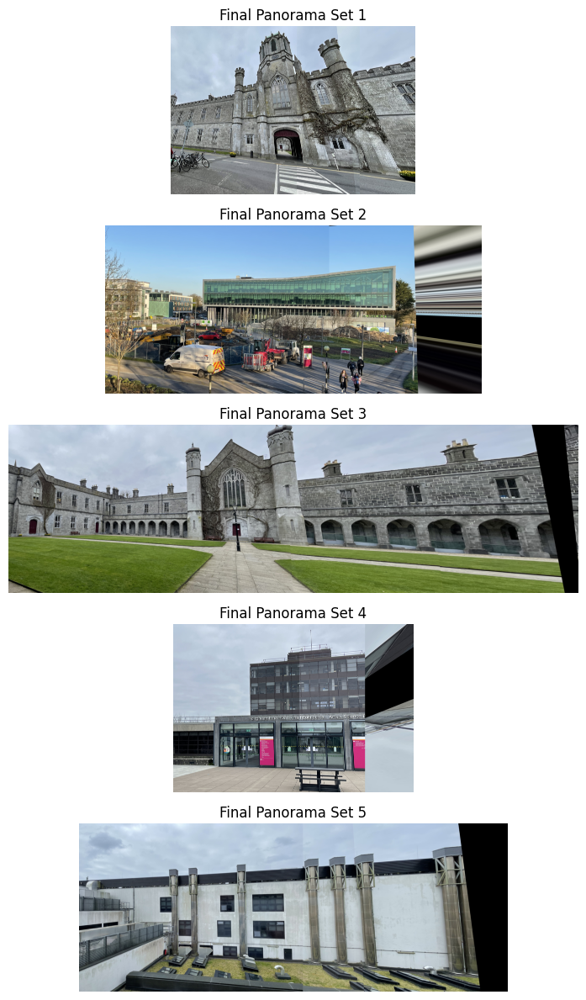

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Define the paths for different image sets
input_paths = [
    'images/set_1/',
    'images/set_2/',
    'images/set_3/',
    'images/set_4/',
    'images/set_5/'
]

# Initialize a list to store final panoramas
final_panoramas = []

# Loop through each image set
for input_path in input_paths:
    filenames = [input_path + filename for filename in os.listdir(input_path)]
    raw_images = [cv2.imread(filename) for filename in filenames]
    count = len(raw_images)

    images = []
    new_idx = (count - 1) // 2
    k = -1
    for i in range(count):
        new_idx = new_idx + k * i
        images.append(raw_images[new_idx])
        k *= -1

    img_src = images[0]

    for i in range(1, len(images)):
        img_dst = images[i]
        if i % 2 == 0:
            img_src, img_dst = img_dst, img_src

        orb = cv2.ORB_create()
        kp1, des1 = orb.detectAndCompute(img_src, None)
        kp2, des2 = orb.detectAndCompute(img_dst, None)

        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
        matches = bf.match(des1, des2)

        matches = sorted(matches, key=lambda x: x.distance)
        matches = matches[:50]

        src_pts = np.zeros((len(matches), 2), dtype=np.float32).reshape(-1, 1, 2)
        dst_pts = np.zeros((len(matches), 2), dtype=np.float32).reshape(-1, 1, 2)
        for i, match in enumerate(matches):
            src_pts[i, :] = kp1[match.queryIdx].pt
            dst_pts[i, :] = kp2[match.trainIdx].pt

        M, mask = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)

        h1, w1, p1 = img_src.shape
        h2, w2, p2 = img_dst.shape
        h = np.maximum(h1, h2)
        w = np.maximum(w1, w2)

        move_dis = int(np.maximum(dst_pts[0][0][0], src_pts[0][0][0]))

        img_transform = cv2.warpPerspective(img_dst, M, (w1 + w2 - move_dis, h))
        img_transform[0:h1, 0:w1] = img_src

        img_src = img_transform

    # Store the final panorama for this set
    final_panoramas.append(img_transform)

# Display all five final panoramas in a single plot
plt.figure(figsize=(20, 12))

for i in range(len(final_panoramas)):
    plt.subplot(len(final_panoramas), 1, i + 1)
    plt.imshow(cv2.cvtColor(final_panoramas[i], cv2.COLOR_BGR2RGB))
    plt.title(f"Final Panorama Set {i + 1}")
    plt.axis('off')

plt.tight_layout()
plt.show()


## Overview of Panorama Stitching Results for Each Image Set:

##### **Set 1:**
- The panorama stitching results are smooth overall, with only minor perspective errors observed in the bottom right corner of the image.
- The width and height of the final panorama were reduced to account for necessary perspective adjustments.

##### **Set 2:**
- Significant issues were encountered in this set. Incorrect keypoint matching caused the trees on the right to align improperly with the trees in the center, leading to severe perspective warping.
- To resolve this, reducing the number of mapped keypoints or selecting specific regions for matching could improve the alignment.

##### **Set 3:**
- Due to the large number of images being stitched, multiple significant errors are present in the final panorama.
- In addition to noticeable perspective distortions, a large section on the right side is missing, likely a result of extreme warping and inaccurate keypoint matching.

##### **Set 4:**
- Similar to Set 2, the first two images are stitched correctly, but errors appear as additional images are added.
- Incorrect keypoint mapping causes elements like the right-hand doors to be incorrectly aligned due to their high similarity, resulting in a severely stretched and distorted panorama.

##### **Set 5:**
- The panorama displays well, with minimal brightness or contrast variations between images.
- However, alignment issues persist, especially with elements like the skylights in the bottom right. The effectiveness of perspective correction diminishes as more images are added.
- A black border is visible on the right side, which is trimmed in post-processing.

---

### Identified Issues & Potential Fixes:

- **Artifacts in output:** 
  - In both Set 2 and Set 4, significant artifacts are present, primarily due to inaccurate keypoint matching and perspective distortions.
  
- **Poor final perspective in some cases:** 
  - Images further from the center require greater warping, negatively affecting the overall panorama. Mapping images to a cylindrical plane could improve the perspective consistency.

- **Black borders in the panorama:** 
  - These borders arise from image warping to adjust for perspective and trimming overlapping regions. Future work could involve more precise cropping techniques to reduce this effect.

- **Brightness mismatches:** 
  - Variations in camera settings (e.g., sunlight, focus, angle) contribute to brightness inconsistencies. Exposure adjustments before stitching may help mitigate these issues.

- **Sharp transitions between images:** 
  - Sharp transitions may result from lighting or contrast differences or from a failure to accurately map perspectives. Using more advanced blending techniques could help smooth these transitions.


#### Final Adjustments & Comments
In an effort to remove black pixels and borders from the panorama, I implemented a method to retain only the complete image area. The most effective approach I achieved involved removing all rectangular sections of the black border. 

A more sophisticated solution would involve calculating the largest interior rectangle within the panorama's polygonal boundary. However, implementing this without relying on external libraries proved to be challenging and time-consuming. While not optimal, the current implementation still provides some level of improvement. Below is the initial, simplified approach!


C:\Users\suder\AppData\Local\Temp\ipykernel_11228\8721970.py:13: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box = np.int0(box)


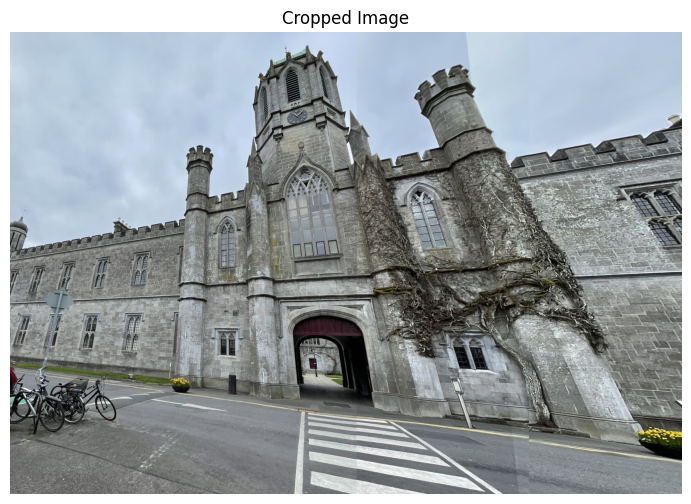

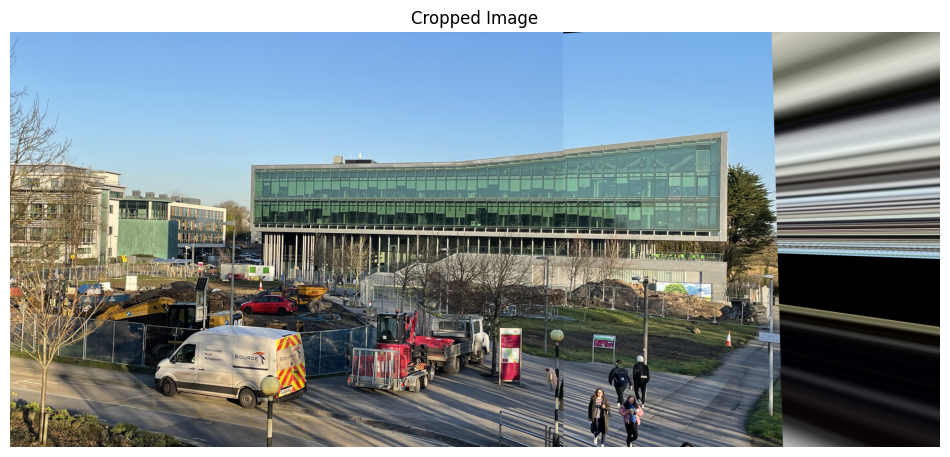

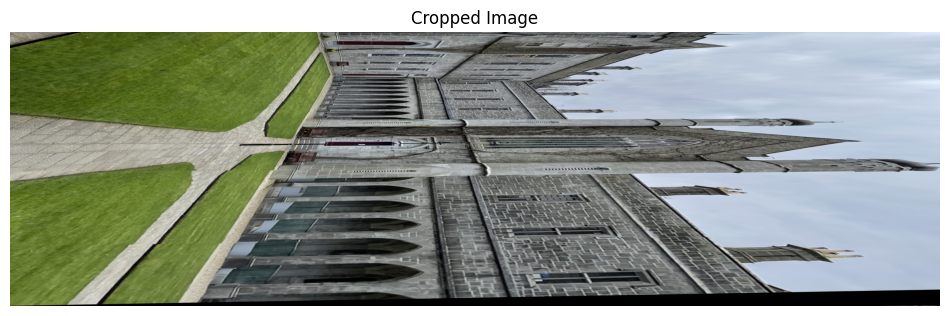

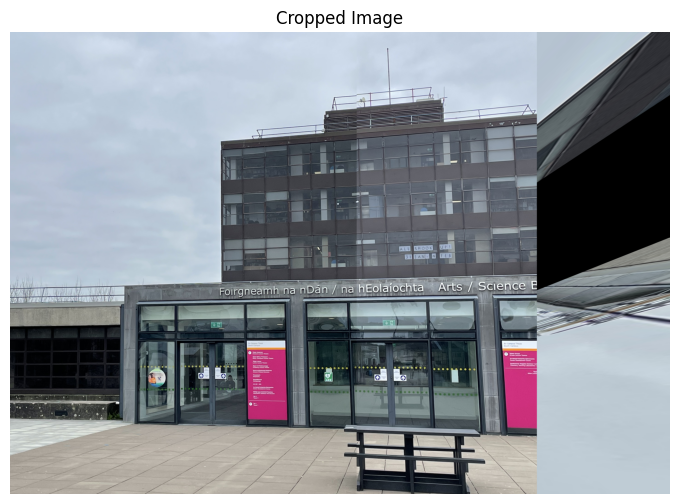

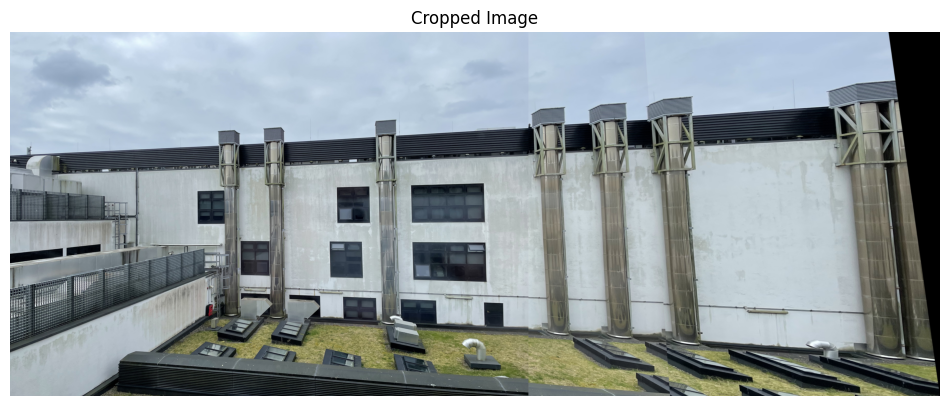

In [4]:
def transform_panorama(image):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Apply a threshold to the image
    ret, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
    # Find the largest contour in the image
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnt = max(contours, key=cv2.contourArea)

    # Stretch the underlying image to fit a rectangle the size of the figure
    rect = cv2.minAreaRect(cnt)
    box = cv2.boxPoints(rect)
    box = np.int0(box)

    # Get the destination rectangle points
    dst_rect = np.array([[0, 0], [image.shape[1] - 1, 0], [image.shape[1] - 1, image.shape[0] - 1], [0, image.shape[0] - 1]], dtype=np.float32)

    # Calculate the perspective transformation matrix
    M = cv2.getPerspectiveTransform(box.astype(np.float32), dst_rect)

    # Apply the perspective transformation to the underlying image
    warped_img = cv2.warpPerspective(image, M, (image.shape[1], image.shape[0]))

    # Plot the result
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(warped_img, cv2.COLOR_BGR2RGB))
    plt.title("Cropped Image")
    plt.axis('off')
    plt.show()

for i in range(len(final_panoramas)):
    transform_panorama(final_panoramas[i])


